#                                                 x19220618_DAP_NursingData_CA02

# Table of Contents

1. [Objective](#section1)<br>
2. [Importing Packages](#section2)<br>
3. [Loading Json Data file on to MongoDB](#section3)<br>
4. [Storing the MongoDB Data in a Pandas Dataframe](#section4)<br>
5. [Data Pre-Processing](#section5)
  - 5.1 [Data Pre-Processing - Pandas Pre-Profiling](#section501)<br>
  - 5.2 [Removing Irrelevant Columns](#section502)<br>
  - 5.3 [Fixing the datatype of each columns](#section503)<br>
  - 5.4 [Filling in missing values](#section504)<br>
  <br>
6. [Data Post-Processing](#section6)<br>
7. [Loading the Data to Postgresql Database](#section7)
  - 7.1 [Update Column Name](#section701)<br>
  - 7.2 [Save the Dataframe in a csv file ](#section702)<br>
  - 7.3 [Creating Database Schema](#section703)<br>
  - 7.4 [Establishing Connection with Postgresql ](#section704)<br>
  - 7.5 [Selecting Data from Postgresql and saving it in a Dataframe](#section705)<br>
  <br>
8. [Visualization ](#section8)<br>
  - 8.1 [Top 10 cities in Connecticut with highest number of Covid-19 admissions / suspected cases and confirmed cases](#section801)<br>
  - 8.2 [Total Deaths and Total Covid-19 Deaths reported during Covid-19 Pandemic](#section802)<br>
  - 8.3 [Total number of Beds and the Total number of Beds Occupied during Covid-19 Pandemic](#section803)<br>
  - 8.4 [Percentage of nursing staff/ aides and clinical staff shortage observed during Covid-19 Pandemic](#section804)<br>
  - 8.5 [Total number of staff suspected/confirmed /died of Covid-19 ](#section805)<br>
  <br>


## 1. Objective<a id=section1></a>
Database and Analytics Programming on Nursing Data of Connecticut (The United States), to understand the patient admissions, suspected covid patients,  deaths, staff occupancy during the Covid-19 Pandemic (year 2020-2021) using Python libraries, MongoDB, Postgresql and Matplotlib.

<a id=section2></a>
## 2. Importing Packages

In [3]:
#Below mentioned packages were used to perform Data Analysis on the Nursing Dataset
import pymongo as md
from pymongo import MongoClient # Required to import data onto MongoDB
#!pip install pandas-profiling==2.8.0 #To be run if Pandas Profiling is not already installed
import pandas_profiling as ppf  #Required to generate report before and after data pre-processing, to understand the features better
import json #to handle json file
import pprint
#To work with dataframes
import pandas as pd 
import numpy as np
#to work with date columns
import datetime
from datetime import date
# for plotting charts
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gs
import matplotlib.dates as mdates
import seaborn as sns
import plotly as pl 
import plotly.express as px
import plotly.graph_objects as go
# To establish connection with Postgresql
import psycopg2 
import pandas.io.sql as sqlio
import plotly.io as pio
pio.renderers.default = "notebook_connected"
#pio.renderers

In [9]:
##Postgrsql Username and password
user = 'postgres'
pwd  ='abcd1234'

<a id=section3></a>
## 3. Loading Json Data file on to MongoDB

In [2]:
#Defining filepath for json file

filepath1 = 'NursingData.json'

try :
    with open(filepath1) as file:  #opening json file
         file_data = json.load(file)  # loading json file
         #return file_data  # returning loaded json file
         print ("File Loaded Successfully")
except FileNotFoundError:  #exception for file not found
    print('Could not open the file:'.format(xmlfile))
except IOError:  #exception for IO error
    print('Could not read from the file:'.format(xmlfile))
    
finally : 
    file.close()
    


File Loaded Successfully


In [3]:
# file_data

In [3]:
#Establishing Connection - reference :- https://www.geeksforgeeks.org/mongodb-python-insert-update-data/
try:
    client = MongoClient('localhost', 27017)
    print("Connection Successful!")
except:
    print("Unable to Connect to MongoDB")

Connection Successful!


In [4]:
#Since my pymongo version is 2.8 I am using insert function to load the data
db = client['NData'] #Creating db and db name is NData
collection_01 = db['NDataset']
try:
    collection_01.insert(file_data) #Inserting the loaded json file in line 2 to MongoDB
    print("Connection Successful!")
except:
    collection_01.insert_one(file_data) #Inserting the loaded json file in line 2 to MongoDB
    print("Connection Successful!")
    #print("Unable to Connect to MongoDB")




ObjectId('6082f887fa557b52802a5b91')

<a id=section4></a>
## 4. Storing the MongoDB Data in a Pandas Dataframe 

In [5]:
try:
    data = pd.DataFrame(list(collection_01.find())) # storing value from Mongodb in a dataframe
    print("Data stored in Dataframe")
except:
    print("Data Couldn't be retreived")

Data stored in Dataframe


In [6]:
df1 = pd.DataFrame(data["meta"][0]["view"]["columns"])# Fetching data details from the MongoDB
df1 # To view the data stored in the dataframe
#Note: As we can see below the column name is stored in the name column and the datatype of the column is stored in the dataTypeName column

,id,name,dataTypeName,fieldName,position,renderTypeName,format,flags,description,tableColumnId,cachedContents
0,-1,sid,meta_data,:sid,0,meta_data,{},[hidden],NaN,NaN,NaN
1,-1,id,meta_data,:id,0,meta_data,{},[hidden],NaN,NaN,NaN
2,-1,position,meta_data,:position,0,meta_data,{},[hidden],NaN,NaN,NaN
3,-1,created_at,meta_data,:created_at,0,meta_data,{},[hidden],NaN,NaN,NaN
4,-1,created_meta,meta_data,:created_meta,0,meta_data,{},[hidden],NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
123,517656655,Number of Staff and/or Personnel with a New Po...,number,number_of_staff_and_or_personnel_with_a_new_po...,117,number,{},NaN,Of the number of reported staff and facility p...,127037671.0,"{'non_null': '3342', 'largest': '4', 'null': '..."
124,517656667,Number of Staff and/or Personnel with a New Po...,number,number_of_staff_and_or_personnel_with_a_new_po...,118,number,{},NaN,Of the number of reported staff and facility p...,127037683.0,"{'non_null': '3342', 'largest': '3', 'null': '..."
125,517656645,Number of Staff and/or Personnel with New Infl...,number,number_of_staff_and_or_personnel_with_new_infl...,119,number,{},NaN,Number of staff and facility personnel with a ...,127037661.0,"{'non_null': '3344', 'largest': '3', 'null': '..."
126,517656673,Number of Staff and/or Personnel with Acute Re...,number,number_of_staff_and_or_personnel_with_acute_re...,120,number,{},NaN,Number of staff and facility personnel with ac...,127037689.0,"{'non_null': '3344', 'largest': '26', 'null': ..."


In [9]:
Columns = [] #Defining an empty list to store the column names fetched from the 'Col_Extract' function

def Col_Extract(df): #Define a function to extract column names from the columns
    for name in df["name"]:
        Columns.append(name)
        
Col_Extract(df1) # Calling the function to store just the column names
#print(Columns)

In [10]:
Columns_Desc = [] #Defining an empty list to store the column names fetched from the 'Col_Extract' function

def Col_Desc(df): #Define a function to extract column names from the columns
    for name in df["description"]:
        Columns_Desc.append(name)
        
Col_Desc(df1) # Calling the function to store just the column description
#print(Columns_Desc)

In [11]:
Data_Desc = pd.DataFrame()
Data_Desc['Columns'] = Columns # Adding column name to Data_Desc Dataframe
Data_Desc['Col_Description'] = Columns_Desc # Adding column description to Data_Desc Dataframe
Data_Desc.head(120)

,Columns,Col_Description
0,sid,NaN
1,id,NaN
2,position,NaN
3,created_at,NaN
4,created_meta,NaN
...,...,...
115,Number of Residents with Confirmed Coinfection...,Number of residents with a confirmed co-infect...
116,During Past Two Weeks Average Time to Receive ...,"During the past two weeks, on average, how lon..."
117,Number of Staff and/or Personnel with a New Po...,Number of staff and facility personnel with a ...
118,Number of Staff and/or Personnel with a New Po...,Of the number of staff and facility personnel ...


In [12]:
#Fetching data from MongoDB and saving it against the columns fetched in step 2.3
#reference -https://stackoverflow.com/questions/33347906/getting-nested-data-from-mongodb-into-a-pandas-data-frame
sdata = pd.DataFrame(data["data"][0], columns = Columns)
sdata.head() #Viewing the dataframe

,sid,id,position,created_at,created_meta,updated_at,updated_meta,meta,Week Ending,Federal Provider Number,...,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive NAAT (PCR) Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test AND Negative NAAT (PCR) Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Any Other Combination of Antigen Test and/or NAAT (PCR) Test with At Least One Positive Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Symptomatic,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Asymptomatic,Number of Staff and/or Personnel with New Influenza,Number of Staff and/or Personnel with Acute Respiratory Illness Symptoms Excluding COVID-19 and/or Influenza,Number of Staff and/or Personnel with Confirmed Coinfection with Influenza and COVID-19
0,row-2y8i.35tn-iv8d,00000000-0000-0000-0911-CC635E201B91,0,1617271542,None,1617271542,None,{ },2020-05-24T00:00:00,075413,...,None,None,None,None,None,None,None,None,None,None
1,row-egtm-fju8~pkix,00000000-0000-0000-42EB-075BCEFE0CEE,0,1617271542,None,1617271542,None,{ },2020-05-24T00:00:00,075438,...,None,None,None,None,None,None,None,None,None,None
2,row-5ba8-ff38.zjcu,00000000-0000-0000-D242-6FA08E11A95C,0,1617271542,None,1617271542,None,{ },2020-07-19T00:00:00,075328,...,None,None,None,None,None,None,None,None,None,None
3,row-7q9y~a5dq~nrvs,00000000-0000-0000-B5E7-0E72701C7E00,0,1617271542,None,1617271542,None,{ },2020-06-28T00:00:00,075300,...,None,None,None,None,None,None,None,None,None,None
4,row-q8z4-hkvn.egaz,00000000-0000-0000-FF4C-AF604FE80BEB,0,1617271542,None,1617271542,None,{ },2020-09-13T00:00:00,075069,...,None,None,None,None,None,None,None,None,None,None


In [13]:
sdata.drop(sdata.columns[0:8], axis = 1, inplace = True)#dropping metadata columns from the dataframe
sdata.head()

,Week Ending,Federal Provider Number,Provider Name,Provider Address,Provider City,Provider State,Provider Zip Code,Submitted Data,Passed Quality Assurance Check,Residents Weekly Admissions COVID-19,...,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive NAAT (PCR) Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test AND Negative NAAT (PCR) Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Any Other Combination of Antigen Test and/or NAAT (PCR) Test with At Least One Positive Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Symptomatic,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Asymptomatic,Number of Staff and/or Personnel with New Influenza,Number of Staff and/or Personnel with Acute Respiratory Illness Symptoms Excluding COVID-19 and/or Influenza,Number of Staff and/or Personnel with Confirmed Coinfection with Influenza and COVID-19
0,2020-05-24T00:00:00,075413,NORTHBRIDGE HEALTH CARE CENTER,2875 MAIN STREET,BRIDGEPORT,CT,06606,Y,Y,25,...,None,None,None,None,None,None,None,None,None,None
1,2020-05-24T00:00:00,075438,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",5 RICHARD BROWN DRIVE,UNCASVILLE,CT,06382,N,None,None,...,None,None,None,None,None,None,None,None,None,None
2,2020-07-19T00:00:00,075328,WATROUS NURSING CENTER,9 NECK ROAD,MADISON,CT,06443,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None
3,2020-06-28T00:00:00,075300,APPLE REHAB SHELTON LAKES,5 LAKE ROAD,SHELTON,CT,06484,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None
4,2020-09-13T00:00:00,075069,REGALCARE AT GREENWICH,1188 KING STREET,GREENWICH,CT,06831,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None


In [14]:
#To count total number of columns having null values
count = [col for col in sdata.columns if sdata[col].isnull().any()] # Applying for loop to loop through all the columns to check null values
print (len(count)) # To print the total count of the columns with null values

110


In [15]:
NData_final = pd.DataFrame(sdata) # Saving the sdata dataframe in a new dataframe, where pre-processing will be performed
NData_final.head()

,Week Ending,Federal Provider Number,Provider Name,Provider Address,Provider City,Provider State,Provider Zip Code,Submitted Data,Passed Quality Assurance Check,Residents Weekly Admissions COVID-19,...,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive NAAT (PCR) Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test AND Negative NAAT (PCR) Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Any Other Combination of Antigen Test and/or NAAT (PCR) Test with At Least One Positive Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Symptomatic,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Asymptomatic,Number of Staff and/or Personnel with New Influenza,Number of Staff and/or Personnel with Acute Respiratory Illness Symptoms Excluding COVID-19 and/or Influenza,Number of Staff and/or Personnel with Confirmed Coinfection with Influenza and COVID-19
0,2020-05-24T00:00:00,075413,NORTHBRIDGE HEALTH CARE CENTER,2875 MAIN STREET,BRIDGEPORT,CT,06606,Y,Y,25,...,None,None,None,None,None,None,None,None,None,None
1,2020-05-24T00:00:00,075438,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",5 RICHARD BROWN DRIVE,UNCASVILLE,CT,06382,N,None,None,...,None,None,None,None,None,None,None,None,None,None
2,2020-07-19T00:00:00,075328,WATROUS NURSING CENTER,9 NECK ROAD,MADISON,CT,06443,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None
3,2020-06-28T00:00:00,075300,APPLE REHAB SHELTON LAKES,5 LAKE ROAD,SHELTON,CT,06484,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None
4,2020-09-13T00:00:00,075069,REGALCARE AT GREENWICH,1188 KING STREET,GREENWICH,CT,06831,Y,Y,0,...,None,None,None,None,None,None,None,None,None,None


In [16]:
NData_final.describe()

,Week Ending,Federal Provider Number,Provider Name,Provider Address,Provider City,Provider State,Provider Zip Code,Submitted Data,Passed Quality Assurance Check,Residents Weekly Admissions COVID-19,...,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive NAAT (PCR) Test Only,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Positive Antigen Test AND Negative NAAT (PCR) Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result with Any Other Combination of Antigen Test and/or NAAT (PCR) Test with At Least One Positive Test,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Symptomatic,Number of Staff and/or Personnel with a New Positive COVID-19 Test Result who are Reinfected and Asymptomatic,Number of Staff and/or Personnel with New Influenza,Number of Staff and/or Personnel with Acute Respiratory Illness Symptoms Excluding COVID-19 and/or Influenza,Number of Staff and/or Personnel with Confirmed Coinfection with Influenza and COVID-19
count,9082,9082,9082,9082,9082,9082,9082,9082,9068,9031,...,3343,3343,3343,3343,3343,3342,3342,3344,3344,3343
unique,43,212,212,211,100,1,118,2,2,35,...,17,17,7,14,5,3,4,4,9,3
top,2020-09-13T00:00:00,075413,PILGRIM MANOR,7003 MAIN STREET,WATERBURY,CT,06450,Y,Y,0,...,0,0,0,0,0,0,0,0,0,0
freq,212,43,43,86,334,9082,301,9068,9009,7532,...,2885,2431,3267,3045,3307,3331,3318,3337,3245,3340


<a id=section5></a>
## 5. Data Pre-Processing

<a id=section501></a>
## 5.1 Data Pre-Processing - Pandas Pre-Profiling
Pandas profiling will give an overview of each column depending on it's data type,e.g. type inference, details about duplicate records, missing value, histogram, etc.

In [17]:
#Run Pandas Pre-Profiling report to understand the features 
# Saving the output as profiling_before_preprocessing.html
# Profile_1 = ppf.ProfileReport(NData_final,title = "Nursing Data Pre-processing File 01")
# Profile_1.to_file(output_file ="Nursing Data Pre-processing" )
# # To output the pandas profiling report on the notebook.
# Profile_1

C:\Users\ashwi\anaconda3\lib\site-packages\pandas_profiling\model\correlations.py:107: UserWarning:

There was an attempt to calculate the cramers correlation, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(correlations={"cramers": {"calculate": False}})`
If this is problematic for your use case, please report this as an issue:
https://github.com/pandas-profiling/pandas-profiling/issues
(include the error message: 'No data; `observed` has size 0.')



C:\Users\ashwi\anaconda3\lib\site-packages\pandas_profiling\profile_report.py:251: UserWarning:

Extension  not supported. For now we assume .html was intended. To remove this warning, please use .html or .json.



The report generated by Pandas Profiling helps us understand each feature in detail.
**Important Observations from Pandas Profiling before Data Processing** <br><br>
__Dataset info__:
- Total number of variables: 120
- Number of observations: 9082
- Missing cells: 46595 (36.9%)


__Variables types__: 
- Categorical = 68
- Boolean = 52

<br>
Some of the key observations from the pre-profiling report are mentioned below:

- **The Provider Number, Provider Name, Provider City , Provider Address and Provider Zip Code** are correlated and highly cardinal.


- **Provider State is constant** and the data is only for Connecticut State of The United States.


-  **Submitted Data and Passed Assurance Quality check** columns has only 2 distinct values and 99% values are 'Y'. This column is not providing any pattern or any additional information.


- Residents Weekly Admissions COVID-19, Residents Total Admissions COVID-19, Residents Weekly Confirmed COVID-19, Residents Total Confirmed COVID-19, Residents Weekly Suspected COVID-19, Residents Total Suspected COVID-19 , Residents Weekly All Deaths,Residents Total All Deaths, Residents Weekly COVID-19 Deaths, Residents Total COVID-19 Deaths, number of Beds and Total Number of beds are all marked as **categorical incorrectly** instead of **numeric**.


- Residents access to testing in facility, Laboratory Type Is State Health Dept, Laboratory Type Is Private Lab, Laboratory Type Is Other, One-Week Supply of Ventilator Supplies, Reason for Not Testing Residents - Lack of Supplies, Reason for Not Testing Residents - Lack of Access to Laboratory, Reason for Not Testing Residents - Lack of Access to Trained Personnel, Reason for Not Testing Residents - Uncertainty About Reimbursement Boolean has **more than 65% missing values** approximately.


- **Reason for Not Testing Residents - Other, Reason for Not Testing Staff and/or Personnel - Lack of PPE for Personnel and Number of Residents with Confirmed Coinfection with Influenza and COVID-19** rows has only **1 distinct value or no values are being populated**


- Reason for Not Testing Staff and/or Personnel - Lack of Supplies, Reason for Not Testing Staff and/or Personnel - Lack of Access to Laboratory, Reason for Not Testing Staff and/or Personnel - Lack of Access to Trained Personnel are some of the columns that have 1 dominant value and the rest of the values was very minimal in count and approximately 60% of the rows are not populated with any value. Such columns are not adding any additional value to the data.


- Columns **Weekly Resident COVID-19 Deaths Per 1,000 Residents, Weekly Resident Confirmed COVID-19 Cases Per 1,000 Residents** has 1 dominant value which is approximately 90%.


<a id=section502></a>
## 5.2 Removing Irrelevant Columns

**Deleting columns where missing value is more than 60%**

Reference1 - How to Perform Data Cleaning for Machine Learning with Python by Jason Brownlee on March 20, 2020
link - https://machinelearningmastery.com/basic-data-cleaning-for-machine-learning/
<br>
Reference 2 - Deep Learning with Structured Data by Mark Ryan

In [17]:
#applying for loop to delete columns with missing value more than 60%
#print('The below mentioned columns has more than 60% missing rows')
for col in NData_final:  # for loop to iterate over each columns in the dataframe
    count = NData_final[col].isnull().sum() #storing the count of null values in the selected column
    col_percent = (count/len(NData_final))*100 # calculating the percentage of missing values
    if col_percent > 60:  # applying an if condition to check whether the missing value is more than 60% 
        #print(NData_final[col].name) # Printing the column names having missing values with more than 60%
        NData_final.drop(col,axis=1,inplace=True) # deleting the column

In [19]:
NData_final

,Week Ending,Federal Provider Number,Provider Name,Provider Address,Provider City,Provider State,Provider Zip Code,Submitted Data,Passed Quality Assurance Check,Residents Weekly Admissions COVID-19,...,County,Geolocation,Initial Confirmed COVID-19 Case This Week,Able to Test or Obtain Resources to Test All Current Residents Within Next 7 Days,Able to Test or Obtain Resources to Test All Staff and/or Personnel Within Next 7 Days,COVID-19 Point-of-Care Tests Performed on Residents Since Last Report,COVID-19 Point-of-Care Tests Performed on Staff and/or Personnel Since Last Report,"Weekly Resident Confirmed COVID-19 Cases Per 1,000 Residents","Weekly Resident COVID-19 Deaths Per 1,000 Residents",Reporting Interval
0,2020-05-24T00:00:00,075413,NORTHBRIDGE HEALTH CARE CENTER,2875 MAIN STREET,BRIDGEPORT,CT,06606,Y,Y,25,...,Fairfield,POINT (-73.203493 41.201508),NaN,NaN,NaN,NaN,NaN,NaN,NaN,Week 01 - May 24
1,2020-05-24T00:00:00,075438,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",5 RICHARD BROWN DRIVE,UNCASVILLE,CT,06382,N,NaN,NaN,...,New London,POINT (-72.112266 41.49273),NaN,NaN,NaN,NaN,NaN,NaN,NaN,Week 01 - May 24
2,2020-07-19T00:00:00,075328,WATROUS NURSING CENTER,9 NECK ROAD,MADISON,CT,06443,Y,Y,0,...,New Haven,POINT (-72.62663300000001 41.277675),N,NaN,NaN,NaN,NaN,0.0,0.0,Week 09 - Jul 19
3,2020-06-28T00:00:00,075300,APPLE REHAB SHELTON LAKES,5 LAKE ROAD,SHELTON,CT,06484,Y,Y,0,...,Fairfield,POINT (-73.115165 41.313756),N,NaN,NaN,NaN,NaN,0.0,0.0,Week 06 - Jun 28
4,2020-09-13T00:00:00,075069,REGALCARE AT GREENWICH,1188 KING STREET,GREENWICH,CT,06831,Y,Y,0,...,Fairfield,POINT (-73.69491 41.062693),N,Y,Y,0,0,0.0,0.0,Week 17 - Sep 13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9077,2020-08-23T00:00:00,075356,NOTRE DAME CONVALESCENT HOME I,76 WEST ROCKS ROAD,NORWALK,CT,06851,Y,Y,0,...,Fairfield,POINT (-73.413866 41.133415),N,Y,Y,NaN,NaN,0.0,0.0,Week 14 - Aug 23
9078,2021-01-24T00:00:00,075230,LEDGECREST HEALTH CARE,154 KENSINGTON RD,KENSINGTON,CT,06037,Y,Y,0,...,Hartford,POINT (-72.769758 41.629581),N,Y,Y,0,0,41.7,0.0,Week 36 - Jan 24
9079,2021-01-31T00:00:00,075443,JOHN L. LEVITOW HEALTH CARE CENTER,287 WEST ST,ROCKY HILL,CT,06067,Y,Y,0,...,Hartford,POINT (-72.650091 41.653404),N,Y,Y,1,19,12.3,0.0,Week 37 - Jan 31
9080,2020-12-06T00:00:00,075300,APPLE REHAB SHELTON LAKES,5 LAKE ROAD,SHELTON,CT,06484,Y,Y,0,...,Fairfield,POINT (-73.115165 41.313756),N,Y,Y,7,8,215.2,0.0,Week 29 - Dec 6


As we can see from the above dataframe details, out of 120 columns only 58 columns are remaining and the rest of the deleted columns were deleted as it has missing values more than 60%.

**Deleting Columns with constant values and high correlation**

In [18]:
#Deleting columns using drop function
NData_final.drop(['Federal Provider Number','Provider Address','Provider State','Provider Zip Code',
                    'Submitted Data','Passed Quality Assurance Check','Residents Weekly Suspected COVID-19',
                    'Staff Weekly COVID-19 Deaths','County','Geolocation'], axis=1, inplace=True)

NData_final.drop(['Reporting Interval'], axis=1, inplace=True)

In [19]:
NData_final.drop(['Residents Weekly Admissions COVID-19'],axis=1,inplace =True) #This column has 0 value in 82% of the observations
NData_final.drop(['Residents Weekly Confirmed COVID-19'],axis=1,inplace =True) #This column has 0 value in 82% of the observations
NData_final.drop(['Residents Weekly COVID-19 Deaths'],axis=1,inplace =True) #This column has has 0 value in 90% of the observations

#The below mentioned columns has one major dominant value which is more than 80% approximately, so the column is not providing any useful insight
NData_final.drop(['Any Current Supply of Gowns'],axis=1,inplace =True)
NData_final.drop(['Any Current Supply of Gloves'],axis=1,inplace =True)
NData_final.drop(['One-Week Supply of Gloves'],axis=1,inplace =True)

NData_final.drop(['One-Week Supply of Hand Sanitizer'],axis=1,inplace =True)
NData_final.drop(['Ventilator Dependent Unit'],axis=1,inplace =True)
NData_final.drop(['Initial Confirmed COVID-19 Case This Week'],axis=1,inplace =True)
NData_final.drop(['Weekly Resident COVID-19 Deaths Per 1,000 Residents'],axis=1,inplace =True)
#NData_final.drop(['Residents Weekly Admissions COVID-19'],axis=1,inplace =True)

NData_final.drop(['Weekly Resident Confirmed COVID-19 Cases Per 1,000 Residents'],axis = 1,inplace = True)


In [20]:
#Below mentioned columns are highly cardinal

NData_final.drop(['Total Resident Confirmed COVID-19 Cases Per 1,000 Residents'],axis = 1,inplace = True)
NData_final.drop(['Total Resident COVID-19 Deaths Per 1,000 Residents'],axis = 1,inplace = True)
NData_final.drop(['Total Residents COVID-19 Deaths as a Percentage of Confirmed COVID-19 Cases'],axis = 1,inplace = True)
NData_final.drop(['COVID-19 Point-of-Care Tests Performed on Residents Since Last Report'],axis = 1,inplace = True)
NData_final.drop(['COVID-19 Point-of-Care Tests Performed on Staff and/or Personnel Since Last Report'],axis = 1,inplace = True)




In [22]:
NData_final

,Week Ending,Provider Name,Provider City,Residents Total Admissions COVID-19,Residents Total Confirmed COVID-19,Residents Total Suspected COVID-19,Residents Weekly All Deaths,Residents Total All Deaths,Residents Total COVID-19 Deaths,Number of All Beds,...,One-Week Supply of N95 Masks,Any Current Supply of Surgical Masks,One-Week Supply of Surgical Masks,Any Current Supply of Eye Protection,One-Week Supply of Eye Protection,One-Week Supply of Gowns,Any Current Supply of Hand Sanitizer,Three or More Confirmed COVID-19 Cases This Week or Initial Confirmed COVID-19 Case this Week,Able to Test or Obtain Resources to Test All Current Residents Within Next 7 Days,Able to Test or Obtain Resources to Test All Staff and/or Personnel Within Next 7 Days
0,2020-05-24T00:00:00,NORTHBRIDGE HEALTH CARE CENTER,BRIDGEPORT,25,0,0,0,0,0,0,...,Y,Y,Y,Y,Y,Y,Y,NaN,NaN,NaN
1,2020-05-24T00:00:00,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",UNCASVILLE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-07-19T00:00:00,WATROUS NURSING CENTER,MADISON,0,1,1,0,0,0,45,...,Y,Y,Y,Y,Y,Y,Y,N,NaN,NaN
3,2020-06-28T00:00:00,APPLE REHAB SHELTON LAKES,SHELTON,1,0,0,1,2,0,106,...,Y,Y,Y,Y,Y,Y,Y,N,NaN,NaN
4,2020-09-13T00:00:00,REGALCARE AT GREENWICH,GREENWICH,11,12,0,0,28,14,75,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9077,2020-08-23T00:00:00,NOTRE DAME CONVALESCENT HOME I,NORWALK,3,22,38,0,17,13,60,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9078,2021-01-24T00:00:00,LEDGECREST HEALTH CARE,KENSINGTON,6,26,1,0,15,5,55,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9079,2021-01-31T00:00:00,JOHN L. LEVITOW HEALTH CARE CENTER,ROCKY HILL,12,34,0,0,20,7,125,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9080,2020-12-06T00:00:00,APPLE REHAB SHELTON LAKES,SHELTON,8,21,0,1,10,0,106,...,Y,Y,Y,Y,Y,Y,Y,Y,Y,Y


As we can see above, after deleting unwanted columns the features has been reduced to 31.

<a id=section503></a>
## 5.3 Fixing the datatype of each columns


In [21]:
NData_final.info() # To find the datatype of each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                                         Non-Null Count  Dtype 
---  ------                                                                                         --------------  ----- 
 0   Week Ending                                                                                    9082 non-null   object
 1   Provider Name                                                                                  9082 non-null   object
 2   Provider City                                                                                  9082 non-null   object
 3   Residents Total Admissions COVID-19                                                            9031 non-null   object
 4   Residents Total Confirmed COVID-19                                                             9031 non-null   object
 5   Residents Total Suspected C

As we can see above, all the columns are categorised as object when some of the columns hold numberical values e.g. Total number of deaths, number of beds, etc. The data type of such columns needs to be fixed.
<br>Reference: https://thispointer.com/pandas-change-data-type-of-single-or-multiple-columns-of-dataframe-in-python/

In [22]:
#Since the columns has none value, we cannot convert the columns from object data type to integer type.

NData_final['Residents Total Admissions COVID-19'] = NData_final['Residents Total Admissions COVID-19'].astype(float)
NData_final['Residents Total Confirmed COVID-19'] = NData_final['Residents Total Confirmed COVID-19'].astype(float)
NData_final['Residents Total Suspected COVID-19'] = NData_final['Residents Total Suspected COVID-19'].astype(float)
NData_final['Residents Weekly All Deaths'] = NData_final['Residents Weekly All Deaths'].astype(float)
NData_final['Residents Total COVID-19 Deaths'] = NData_final['Residents Total COVID-19 Deaths'].astype(float)
NData_final['Residents Total All Deaths'] = NData_final['Residents Total All Deaths'].astype(float)
NData_final['Number of All Beds'] = NData_final['Number of All Beds'].astype(float)
NData_final['Total Number of Occupied Beds'] = NData_final['Total Number of Occupied Beds'].astype(float)
NData_final['Staff Total Confirmed COVID-19'] = NData_final['Staff Total Confirmed COVID-19'].astype(float)
NData_final['Staff Weekly Suspected COVID-19'] = NData_final['Staff Weekly Suspected COVID-19'].astype(float)
NData_final['Staff Total Suspected COVID-19'] = NData_final['Staff Total Suspected COVID-19'].astype(float)
NData_final['Staff Total COVID-19 Deaths'] = NData_final['Staff Total COVID-19 Deaths'].astype(float)


In [25]:
NData_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                                         Non-Null Count  Dtype  
---  ------                                                                                         --------------  -----  
 0   Week Ending                                                                                    9082 non-null   object 
 1   Provider Name                                                                                  9082 non-null   object 
 2   Provider City                                                                                  9082 non-null   object 
 3   Residents Total Admissions COVID-19                                                            9031 non-null   float64
 4   Residents Total Confirmed COVID-19                                                             9031 non-null   float64
 5   Residents Total Susp

As we can see above, all the numerical columns has been coverted to float.

<a id=section504></a>
## 5.4 Filling in missing values

reference - Fundamental Techniques of Feature Engineering for Machine Learning by Emre Rençberoğlu<br>https://towardsdatascience.com/feature-engineering-for-machine-learning-3a5e293a5114

In [23]:
#Filling all the float variables with median value as for some columns there are outliers.
for col in NData_final:  #for loop to iterate through all the colums in the NData_final dataframe
    if NData_final[col].dtype == float: #To check the condition whether the data type of column is float.
        NData_final[col] = NData_final[col].fillna(NData_final[col].median()) # filling all the missing rows with median value
    

In [27]:
NData_final.info() # Verifying whether all the float columns missing value has been fixed or not

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                                         Non-Null Count  Dtype  
---  ------                                                                                         --------------  -----  
 0   Week Ending                                                                                    9082 non-null   object 
 1   Provider Name                                                                                  9082 non-null   object 
 2   Provider City                                                                                  9082 non-null   object 
 3   Residents Total Admissions COVID-19                                                            9082 non-null   float64
 4   Residents Total Confirmed COVID-19                                                             9082 non-null   float64
 5   Residents Total Susp

As we can see above, all the float variables has been filled with median values

In [24]:
for col in NData_final: 
    if NData_final[col].dtype =='object': #for loop to iterate through all the colums in the NData_final dataframe
         if NData_final[col].isnull().sum() >0: #To check the whether the column datatype is object.
            NData_final[col].fillna(NData_final[col].value_counts().idxmax(), inplace=True) # if the datatype of column is object , code to replace missing value with most frequently occured value

In [29]:
NData_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                                         Non-Null Count  Dtype  
---  ------                                                                                         --------------  -----  
 0   Week Ending                                                                                    9082 non-null   object 
 1   Provider Name                                                                                  9082 non-null   object 
 2   Provider City                                                                                  9082 non-null   object 
 3   Residents Total Admissions COVID-19                                                            9082 non-null   float64
 4   Residents Total Confirmed COVID-19                                                             9082 non-null   float64
 5   Residents Total Susp

As we can see above, all the columns has got 9082 records and there are no missing value.

In [30]:
NData_final

,Week Ending,Provider Name,Provider City,Residents Total Admissions COVID-19,Residents Total Confirmed COVID-19,Residents Total Suspected COVID-19,Residents Weekly All Deaths,Residents Total All Deaths,Residents Total COVID-19 Deaths,Number of All Beds,...,One-Week Supply of N95 Masks,Any Current Supply of Surgical Masks,One-Week Supply of Surgical Masks,Any Current Supply of Eye Protection,One-Week Supply of Eye Protection,One-Week Supply of Gowns,Any Current Supply of Hand Sanitizer,Three or More Confirmed COVID-19 Cases This Week or Initial Confirmed COVID-19 Case this Week,Able to Test or Obtain Resources to Test All Current Residents Within Next 7 Days,Able to Test or Obtain Resources to Test All Staff and/or Personnel Within Next 7 Days
0,2020-05-24T00:00:00,NORTHBRIDGE HEALTH CARE CENTER,BRIDGEPORT,25.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
1,2020-05-24T00:00:00,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",UNCASVILLE,6.0,28.0,3.0,0.0,19.0,7.0,120.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
2,2020-07-19T00:00:00,WATROUS NURSING CENTER,MADISON,0.0,1.0,1.0,0.0,0.0,0.0,45.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
3,2020-06-28T00:00:00,APPLE REHAB SHELTON LAKES,SHELTON,1.0,0.0,0.0,1.0,2.0,0.0,106.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
4,2020-09-13T00:00:00,REGALCARE AT GREENWICH,GREENWICH,11.0,12.0,0.0,0.0,28.0,14.0,75.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9077,2020-08-23T00:00:00,NOTRE DAME CONVALESCENT HOME I,NORWALK,3.0,22.0,38.0,0.0,17.0,13.0,60.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9078,2021-01-24T00:00:00,LEDGECREST HEALTH CARE,KENSINGTON,6.0,26.0,1.0,0.0,15.0,5.0,55.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9079,2021-01-31T00:00:00,JOHN L. LEVITOW HEALTH CARE CENTER,ROCKY HILL,12.0,34.0,0.0,0.0,20.0,7.0,125.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9080,2020-12-06T00:00:00,APPLE REHAB SHELTON LAKES,SHELTON,8.0,21.0,0.0,1.0,10.0,0.0,106.0,...,Y,Y,Y,Y,Y,Y,Y,Y,Y,Y


In [25]:
#Since the columns has none value, we cannot convert the columns from float data type to integer type as the deaths and patient count cannot be float

NData_final['Residents Total Admissions COVID-19'] = NData_final['Residents Total Admissions COVID-19'].astype(int)
NData_final['Residents Total Confirmed COVID-19'] = NData_final['Residents Total Confirmed COVID-19'].astype(int)
NData_final['Residents Total Suspected COVID-19'] = NData_final['Residents Total Suspected COVID-19'].astype(int)
NData_final['Residents Weekly All Deaths'] = NData_final['Residents Weekly All Deaths'].astype(int)
NData_final['Residents Total COVID-19 Deaths'] = NData_final['Residents Total COVID-19 Deaths'].astype(int)
NData_final['Residents Total All Deaths'] = NData_final['Residents Total All Deaths'].astype(int)
NData_final['Number of All Beds'] = NData_final['Number of All Beds'].astype(int)
NData_final['Total Number of Occupied Beds'] = NData_final['Total Number of Occupied Beds'].astype(int)
NData_final['Staff Total Confirmed COVID-19'] = NData_final['Staff Total Confirmed COVID-19'].astype(int)
NData_final['Staff Weekly Suspected COVID-19'] = NData_final['Staff Weekly Suspected COVID-19'].astype(int)
NData_final['Staff Total Suspected COVID-19'] = NData_final['Staff Total Suspected COVID-19'].astype(int)
NData_final['Staff Total COVID-19 Deaths'] = NData_final['Staff Total COVID-19 Deaths'].astype(int)


In [32]:
NData_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                                         Non-Null Count  Dtype 
---  ------                                                                                         --------------  ----- 
 0   Week Ending                                                                                    9082 non-null   object
 1   Provider Name                                                                                  9082 non-null   object
 2   Provider City                                                                                  9082 non-null   object
 3   Residents Total Admissions COVID-19                                                            9082 non-null   int32 
 4   Residents Total Confirmed COVID-19                                                             9082 non-null   int32 
 5   Residents Total Suspected C

<a id=section6></a>
## 6. Data Post-Processing

In [33]:
# #Run Pandas Pre-Profiling report to understand the features 
# # Saving the output as profiling_before_preprocessing.html
Profile_2 = ppf.ProfileReport(NData_final,title = "Nursing Data Post-processing File 01")
Profile_2.to_file(output_file ="Nursing Data Post-processing" )
# To output the pandas profiling report on the notebook.
Profile_2

C:\Users\ashwi\anaconda3\lib\site-packages\pandas_profiling\profile_report.py:251: UserWarning:

Extension  not supported. For now we assume .html was intended. To remove this warning, please use .html or .json.



As we can see in the Post Profiling report, all the missing values has been fixed, the features has been reduced to 31 columns based on the relevance and the data types of the columns are corrected.

# 7. Loading the Data to Postgresql Database<a id=section7></a>



## <a id=section701></a>7 .1 Update Column Name
Before loading the data to Postgresql Database, the column names of dataframe should be updated in lower case and there should be no space in the column name.

In [26]:
#reference - https://cmdlinetips.com/2020/07/cleaning_up_pandas-column-names/
NData_final.columns= NData_final.columns.str.rstrip().str.lower() # Convert all the column names to lower case

In [27]:
#reference - https://www.journaldev.com/23763/python-remove-spaces-from-string#replace
NData_final.columns = NData_final.columns.str.replace(" ", "") # Remove the spaces in the column names

In [28]:
NData_final.info() # Ensure that the column names are updated and there are no spaces in column names

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9082 entries, 0 to 9081
Data columns (total 31 columns):
 #   Column                                                                           Non-Null Count  Dtype 
---  ------                                                                           --------------  ----- 
 0   weekending                                                                       9082 non-null   object
 1   providername                                                                     9082 non-null   object
 2   providercity                                                                     9082 non-null   object
 3   residentstotaladmissionscovid-19                                                 9082 non-null   int32 
 4   residentstotalconfirmedcovid-19                                                  9082 non-null   int32 
 5   residentstotalsuspectedcovid-19                                                  9082 non-null   int32 
 6   residentsweeklya

## 7.2 Save the Dataframe in a csv file <a id=section702></a>

In [29]:
NData_final.to_csv(r'FinalNData.csv',index=False) #Saving the final dataframe in a csv file

## 7.3 Creating Database Schema <a id=section703></a>

In [7]:
# Database Creation Schema with proper datatypes
createTable = """
CREATE TABLE NursingData(
weekending date,
providername varchar,
providercity varchar,
residentstotaladmissionscovid19 numeric,
residentstotalconfirmedcovid19 numeric,
residentstotalsuspectedcovid19 numeric,
residentsweeklyalldeaths numeric,
residentstotalalldeaths numeric,
residentstotalcovid19deaths numeric,
numberofallbeds numeric,
totalnumberofoccupiedbeds numeric,
staffweeklyconfirmedcovid19 numeric,
stafftotalconfirmedcovid19 numeric,
staffweeklysuspectedcovid19 numeric,
stafftotalsuspectedcovid19 numeric,
stafftotalcovid19deaths numeric,
shortageofnursingstaff varchar,
shortageofclinicalstaff varchar,
shortageofaides varchar,
shortageofotherstaff varchar,
anycurrentsupplyofn95masks varchar,
oneweeksupplyofn95masks varchar,
anycurrentsupplyofsurgicalmasks varchar,
oneweeksupplyofsurgicalmasks varchar,
anycurrentsupplyofeyeprotection varchar,
oneweeksupplyofeyeprotection varchar,
oneweeksupplyofgowns varchar,
anycurrentsupplyofhandsanitizer varchar,
threeormoreconfirmedcovid19casesthisweekorinitialconfirmedcovid19casethisweek varchar,
abletotestorobtainresourcestotestallcurrentresidentswithinnext7days varchar,
abletotestorobtainresourcestotestallstaffandorpersonnelwithinnext7days varchar
);
"""

## 7.4 Establishing Connection with Postgresql <a id=section704></a>


In [5]:
#Run the below code for the first run and later comment it as it will create a table
# try:
#     dbConnection = psycopg2.connect(user = user,password = pwd,host = "localhost",port = "5432")
#     dbConnection.set_isolation_level(0) # AUTOCOMMIT
#     dbCursor = dbConnection.cursor()
#     dbCursor.execute('CREATE DATABASE coviddb;')
#     #dbCursor.execute(createTable)
#     dbCursor.close()
# except (Exception , psycopg2.Error) as dbError :
#     print ("Error while connecting to PostgreSQL", dbError)
# finally:
#     if(dbConnection): dbConnection.close()

In [8]:
#Run the below code to set up the connection
try:
    dbConnection = psycopg2.connect(user = user,password = pwd ,host = "localhost",port = "5432",database ='coviddb')
    dbConnection.set_isolation_level(0) # AUTOCOMMIT
    dbCursor = dbConnection.cursor()
    #dbCursor.execute('CREATE DATABASE NursingData;')
    dbCursor.execute(createTable)
    dbCursor.close()
except (Exception , psycopg2.Error) as dbError :
    print ("Error while connecting to PostgreSQL", dbError)
finally:
    if(dbConnection): dbConnection.close()

In [10]:
#Run the below code to feed data into the database table
try:
    dbConnection = psycopg2.connect(user = user ,password = pwd ,host = "localhost",port = "5432", database = "coviddb")
    print("Connected!")
    dbConnection.set_isolation_level(0) # AUTOCOMMIT
    sql = "COPY %s FROM STDIN WITH CSV HEADER DELIMITER AS ','"
    file = open("FinalNData.csv", "r")
    #Inserting data from merged CSV into table in Postgres
    with dbConnection.cursor() as cur:
        #Avoiding uploading duplicate data!
        cur.execute("truncate " + "NursingData" + ";")
        cur.copy_expert(sql=sql % "NursingData", file=file)
        dbConnection.commit()       
except (Exception , psycopg2.Error) as dbError :
    print ("Error:", dbError)
finally:
    if(dbConnection): dbConnection.close()

Connected!


## 7.5 Selecting Data from Postgresql and saving it in a Dataframe <a id=section705></a>

In [37]:
sql = """SELECT * FROM nursingdata;""" #SQL Query
dbConnection = psycopg2.connect(user = user ,password = pwd ,host = "localhost",port = "5432",database = "coviddb") #Establishing connection
NData_dataframe = sqlio.read_sql_query(sql, dbConnection) #executing sql query and saving the results as dictionary
TData = pd.DataFrame().from_dict(NData_dataframe) # Saving the output of executed sql query as dataframe
TData #Displaying the dataframe

,weekending,providername,providercity,residentstotaladmissionscovid19,residentstotalconfirmedcovid19,residentstotalsuspectedcovid19,residentsweeklyalldeaths,residentstotalalldeaths,residentstotalcovid19deaths,numberofallbeds,...,oneweeksupplyofn95masks,anycurrentsupplyofsurgicalmasks,oneweeksupplyofsurgicalmasks,anycurrentsupplyofeyeprotection,oneweeksupplyofeyeprotection,oneweeksupplyofgowns,anycurrentsupplyofhandsanitizer,threeormoreconfirmedcovid19casesthisweekorinitialconfirmedcovid,abletotestorobtainresourcestotestallcurrentresidentswithinnext7,abletotestorobtainresourcestotestallstaffandorpersonnelwithinne
0,2020-05-24,NORTHBRIDGE HEALTH CARE CENTER,BRIDGEPORT,25.0,0.0,0.0,0.0,0.0,0.0,0.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
1,2020-05-24,"ORCHARD GROVE SPECIALTY CARE CENTER, LLC",UNCASVILLE,6.0,28.0,3.0,0.0,19.0,7.0,120.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
2,2020-07-19,WATROUS NURSING CENTER,MADISON,0.0,1.0,1.0,0.0,0.0,0.0,45.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
3,2020-06-28,APPLE REHAB SHELTON LAKES,SHELTON,1.0,0.0,0.0,1.0,2.0,0.0,106.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
4,2020-09-13,REGALCARE AT GREENWICH,GREENWICH,11.0,12.0,0.0,0.0,28.0,14.0,75.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9077,2020-08-23,NOTRE DAME CONVALESCENT HOME I,NORWALK,3.0,22.0,38.0,0.0,17.0,13.0,60.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9078,2021-01-24,LEDGECREST HEALTH CARE,KENSINGTON,6.0,26.0,1.0,0.0,15.0,5.0,55.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9079,2021-01-31,JOHN L. LEVITOW HEALTH CARE CENTER,ROCKY HILL,12.0,34.0,0.0,0.0,20.0,7.0,125.0,...,Y,Y,Y,Y,Y,Y,Y,N,Y,Y
9080,2020-12-06,APPLE REHAB SHELTON LAKES,SHELTON,8.0,21.0,0.0,1.0,10.0,0.0,106.0,...,Y,Y,Y,Y,Y,Y,Y,Y,Y,Y


## 8 Visualization <a id=section8></a>


### 8.1 Top 10 cities in Connecticut with highest number of Covid-19 admissions / suspected cases and confirmed cases<a id=section801></a>

In [38]:
#Creating different data frames to plot residentstotaladmissionscovid19, residentstotalconfirmedcovid19 and residentstotalsuspectedcovid19
cat_totals = NData_dataframe.groupby("providercity")["residentstotaladmissionscovid19"].sum().sort_values(ascending =False).head(10)
cat_totals1 = NData_dataframe.groupby("providercity")["residentstotalconfirmedcovid19"].sum().sort_values(ascending =False).head(10)
cat_totals3 = NData_dataframe.groupby("providercity")["residentstotalsuspectedcovid19"].sum().sort_values(ascending =False).head(10)
cat_totals =cat_totals.reset_index()
cat_totals1 = cat_totals1.reset_index()
cat_totals3 = cat_totals3.reset_index()

In [39]:
cat_totals['residentstotalconfirmedcovid19'] = cat_totals1['residentstotalconfirmedcovid19']
cat_totals['residentstotalsuspectedcovid19'] = cat_totals3['residentstotalsuspectedcovid19']


In [40]:
import plotly.tools as tls
fig = px.treemap(cat_totals, path=['providercity'], values='residentstotaladmissionscovid19', title = "Top 10 cities with highest number of Covid-19 Admissions")
fig.update_layout(title={'text': "Top 10 cities with highest number of Covid-19 Admissions",'y':0.9,'x':0.5,'xanchor': 'center', 'yanchor': 'top'})
#fig.write_html("Top_10_cities_with_Highest_Admissions.html")#Interactive graphs will be visible in the mentioned html file
fig.show()

In [42]:
fig = go.Figure()

fig.add_trace(go.Bar(
    x=cat_totals['providercity'],
    y=cat_totals['residentstotalsuspectedcovid19'],
    name='residentstotalsuspectedcovid19',
    marker_color='rebeccapurple', text= cat_totals["residentstotalsuspectedcovid19"],textposition='auto'
))

fig.add_trace(go.Bar(
    x=cat_totals['providercity'],
    y=cat_totals['residentstotalconfirmedcovid19'],
    name='residentstotalconfirmedcovid19',
    marker_color='rosybrown', text= cat_totals["residentstotalconfirmedcovid19"], textposition='auto' 
))

fig.update_layout(barmode = 'stack',margin=dict(l=30, r=30, t=30, b=30),
    title={'text': "Residents Total Suspected Covid-19 patients v/s Confirmed Covid-19 Patients",'y':1,'x':0.38,'xanchor': 'center', 'yanchor': 'top'})

#fig.write_html("TotalSuspected vs Confirmed covid-19 Patients.html") #Interactive graphs will be visible in the mentioned html file
fig.show()

***The above tree map and the bar chart represents the top 10 cities in Connecticut with highest number of Covid-19 patient admissions, confirmed cases and suspected patients between the time preiod May 2020 to March 2021.*** 
Some of the key inferences are stated below:
1. In Connecticut, ***East Hartford City*** had the highest number of Covid-19 admissions and suspected patient count.
2. ***West Hartford** and **Hartford city** had the maximum number of confirmed covid-19 patients. However, both the cities weren't in the top 10 list of suspected covid-19 cities which indicates that either the Covid-19 test facilities were poor or the patients were **asymptomatic**. We do not have sufficient evidence to prove which of the either possibilities are true.
3. There was only a slight difference between the suspected and confirmed covid-19 patients of the New Haven City.

### 8.2 Total Deaths and Total Covid-19 Deaths reported during Covid-19 Pandemic<a id=section802></a>

In [43]:
df2 = pd.DataFrame(pd.DatetimeIndex(NData_dataframe["weekending"]).year) #Extracting only year from weekending
df2['residentstotalalldeaths']= NData_dataframe['residentstotalalldeaths']
df2['residentstotalcovid19deaths']= NData_dataframe['residentstotalcovid19deaths']
df3 = df2.groupby('weekending', as_index = False)["residentstotalalldeaths", "residentstotalcovid19deaths"].sum()
df3

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:4: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,weekending,residentstotalalldeaths,residentstotalcovid19deaths
0,2020,132699.0,61180.0
1,2021,76991.0,30439.0


In [44]:
#reference - https://plotly.com/python/bar-charts/
fig = go.Figure()
fig.add_trace(go.Bar(
    x=df3["weekending"],
    y=df3["residentstotalalldeaths"],
    name='residentstotalalldeaths',
    marker_color='midnightblue', text= df3["residentstotalalldeaths"],
            textposition='auto'
))
fig.add_trace(go.Bar(
    x=df3["weekending"],
    y=df3["residentstotalcovid19deaths"],
    name='residentstotalcovid19deaths',
    marker_color='teal', text= df3["residentstotalcovid19deaths"], textposition='auto'
))

fig.update_layout(barmode = 'group',
    title={'text': "Total Deaths Vs Covid-19 Deaths",'y':0.9,'x':0.4,'xanchor': 'center', 'yanchor': 'top'})
#fig.write_html("Total Deaths Vs Covid-19 Deaths.html") #Interactive graphs will be visible in the mentioned html file
fig.show()

From the above graph, it has been observed that 46% of the total deaths reported in the year 2020 and 30% of the death reported in the first 3 months of 2021 was due to Covid-19.
**Death reported in the first 3 months of 2021 was approximately 50% of the total death reported in the year 2021** (total 8 months) since the onset of Covid-19. 
To summarize, **Overall Death rate has been increased by 30% due to Covid-19 in Connecticut between May 2020 to March 2021**.


### 8.3 Total number of Beds and the Total number of Beds Occupied during Covid-19 Pandemic<a id=section803></a>

In [45]:
nb1 = NData_dataframe[["residentstotaladmissionscovid19",'numberofallbeds','totalnumberofoccupiedbeds']]
#nb1

ym_id = NData_dataframe['weekending'].apply("{:%Y-%m}".format).rename('Year-Month')
nb1['Year_Month'] = ym_id #Fetching only month and year from the weekending column

nb2 = nb1.groupby("Year_Month", as_index=False)['numberofallbeds','totalnumberofoccupiedbeds'].sum()#Creating new data frame to fetch number of all beds and total number of occupied beds 
#nb2

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:7: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [ ]:
# ym_id = NData_dataframe['weekending'].apply("{:%Y-%m}".format).rename('Year-Month')
# nb1['Year_Month'] = ym_id

In [46]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=nb2["Year_Month"],
    y=nb2["numberofallbeds"],
    name='numberofallbeds',
    marker_color='crimson', text= nb2["numberofallbeds"],
            textposition='auto'
))
fig.add_trace(go.Bar(
    x=nb2["Year_Month"],
    y=nb2["totalnumberofoccupiedbeds"],
    name='totalnumberofoccupiedbeds',
    marker_color='lightsalmon', text= nb2["totalnumberofoccupiedbeds"], textposition='auto'
))

fig.update_layout(barmode = 'group',
    title={'text': "Total Number of Beds Vs Number of Occupied Beds",'y':0.9,'x':0.45,'xanchor': 'center', 'yanchor': 'top'})

#fig.write_html("Total Number of Beds Vs Number of Occupied Beds.html") #Interactive graphs will be visible in the mentioned html file
fig.show()

The above graph **depicts that the total number of beds were more compared to the total number of occupied beds**, the foremost reason could be that most of the **Covid-19 patients were asked to home quarantine as there were no Covid-19 specific treatment available during the initial stage**.
Also, the number of beds occupancy was at **peak during the month of August and November**. Number of beds were occupied during the month of May,2020 and March,2021 were comparatively low.

### 8.4 Percentage of nursing staff/ aides and clinical staff shortage observed during Covid-19 Pandemic<a id=section804></a>

Text(0.5, 1.0, 'Pie chart showing the Shortage of Nursing Staff /Aides and Clinical Staff During the Covid-19 Pandemic')

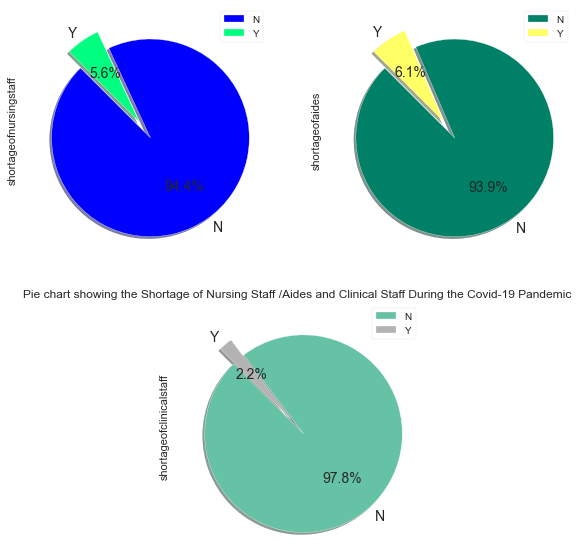

In [47]:

gs1 =gs.GridSpec(2, 2, width_ratios=[4,4]) 
fig, ((ax1),(ax2),(ax3)) = plt.subplots(3,figsize=(12,12))
p1= plt.subplot(gs1[0])
#p1.add_artist(centre_circle)

p0 = NData_dataframe['shortageofnursingstaff'].value_counts().plot(kind='pie',explode = [0.1,0.1], fontsize=14, autopct='%3.1f%%',
                                               figsize=(10,10), shadow=True, startangle=135, legend=True, cmap='winter')
p2= plt.subplot(gs1[1])


#centre_circle = plt.Circle((0,0),0.7,fc ='white')
p01 = NData_dataframe['shortageofaides'].value_counts().plot(kind='pie',explode = [0.1,0.1], fontsize=14, autopct='%3.1f%%',
                                               figsize=(10,10), shadow=True, startangle=135, legend=True, cmap='summer')
p3= plt.subplot(gs1[2:4])
p02 = NData_dataframe['shortageofclinicalstaff'].value_counts().plot(kind='pie',explode = [0.1,0.1], fontsize=14, autopct='%3.1f%%',
                                               figsize=(10,10), shadow=True, startangle=135, legend=True, cmap='Set2')

plt.title('Pie chart showing the Shortage of Nursing Staff /Aides and Clinical Staff During the Covid-19 Pandemic')

***Above pie chart shows the shortage of aides, clinical and nursing staff. It is clearly visibile that the staff shortages faced was less than 6%. However, during the unprecedented pandemic times even 6% shortage of staff had a huge impact on the Connecticut state health system.*** 

In [48]:
ndf2 = NData_dataframe[NData_dataframe['shortageofnursingstaff']=='Y']
ndf2['Year_Month'] = ym_id
ndd = ndf2[['Year_Month','shortageofnursingstaff']]
ndd1 = ndd.groupby("Year_Month", as_index=False).count()##Creating new data frame to fetch months and shortage of nursing staff  observed in the respective month

ndf3 = NData_dataframe[NData_dataframe['shortageofclinicalstaff']=='Y']
ndf3['Year_Month'] = ym_id
ncf = ndf3[['Year_Month','shortageofclinicalstaff']]
ndd2 = ncf.groupby("Year_Month", as_index=False).count()##Creating new data frame to fetch months and shortage of clinical staff  observed in the respective month

ndf4 = NData_dataframe[NData_dataframe['shortageofaides']=='Y']
ndf4['Year_Month'] = ym_id
nad = ndf4[['Year_Month','shortageofaides']]
ndd3 = nad.groupby("Year_Month", as_index=False).count()#Creating new data frame to fetch months and shortage of aides  observed in the respective month


C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/p

In [49]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=ndd1['Year_Month'], y=ndd1['shortageofnursingstaff'],name='shortageofnursingstaff',
    marker_color='orange'))
fig.add_trace(go.Scatter(x=ndd2['Year_Month'], y=ndd2['shortageofclinicalstaff'], name ='shortageofclinicalstaff',marker_color='brown' ))
fig.add_trace(go.Scatter(x=ndd3['Year_Month'], y=ndd3['shortageofaides'], name = 'shortageofaides',marker_color='red'))

fig.update_layout(
    title={'text': "Shortage of Nusing Staffs vs Clinical Staffs vs Aides",'y':0.9,'x':0.45,'xanchor': 'center', 'yanchor': 'top'})
fig.show()

#reference1 - https://ctpublic.org/first-wave-coronavirus-in-connecticut/
#reference2 - https://www.govtech.com/em/safety/Second-Wave-of-COVID-19-Deaths-to-hit-Connecticut-is-Everywhere-.html


The bar plot and the line graph shows the shortage of nursing staff/clinical staff/aides during the Covid-19 pandemic period from May-2020 to March-2021. From the graphs it is visible that the **Shortage of staff and aides were at peak during the month of June-2020** which was the high point of first wave and **then in November-2020 and Jan-2021** which was the Pandemic second wave. Also itcan be observed that **nursing staff shortage and Aides shortage are directly propotional**.

### 8.5 Total number of staff suspected/confirmed /died of Covid-19 <a id=section805></a>

In [50]:
staffdb = NData_dataframe[['stafftotalconfirmedcovid19','stafftotalsuspectedcovid19','stafftotalcovid19deaths'] ]
staffdb['Year_Month']= ym_id
#staffdb

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [51]:
staffdb1= staffdb.groupby('Year_Month')['stafftotalconfirmedcovid19','stafftotalsuspectedcovid19','stafftotalcovid19deaths'].sum()

C:\Users\ashwi\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



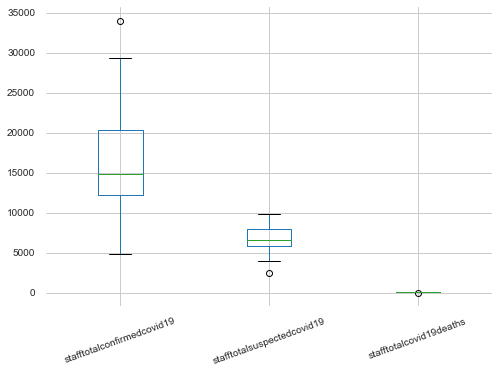

In [52]:
ax1=staffdb1.boxplot()
ax1.tick_params(axis='x', labelrotation = 20 )

for p in ax1.patches:
    print(p)
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy() 
    print(x)
    ax1.annotate(f'{height:}', (x + width/2, y + height*1.02), ha='center')


The above boxplot shows the nursing home staff's count with covid-19 positive, suspected covid-19 positive staff and total staff deaths. ***The boxplot infers that confirmed covid-19 cases were three times more than the suspected covid 19 staffs between the timeperiod May-2020 and March-2021***
